# Calculate the disturbance, the free-air anomaly, and their difference

Here, we'll load the raw gravity and topography data downloaded as part of the [Antarctic-Plots](https://antarctic-plots.readthedocs.io/) package and calculate the anomaly, the disturbance, and their difference. For all calculations, we'll use the WGS84 ellipsoid as the Normal Earth.

This notebook is originally from the supplement of the following article:
Oliveira, V. C., Uieda, L., & Hallam, K. A. T. (2018). Should geophysicists use the gravity disturbance or the anomaly?, 11. https://doi.org/10.5281/zenodo.1255305

In [1]:
%%capture
%load_ext autoreload
%autoreload 2
import boule
import verde
import xarray
import pygmt
from antarctic_plots import maps, utils, regions, fetch

In [2]:
region = regions.antarctica

## Collect data 
The data we need (in the form of netcdf or tiff files) can be downloaded and accessed with the package _Antarctic-Plots_ through the fetch module. 

These dataset will be returned as xarray DataArrays, which are 2D grids of a single variable.

In [3]:
eigen_gravity = fetch.gravity(version='eigen', region=region)

eigen_geoid = fetch.geoid(region=region)

c:\Users\matthewt\AppData\Local\miniforge3\envs\grav_inv_ant_plots\lib\site-packages\xarray\backends\plugins.py:64: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


returning grid with new region and/or registration, same spacing
returning grid with new region and/or registration, same spacing


print out some info about the grids in the following format:

* spacing
* extent
* min value
* max value
* grid registration type

In [4]:
print("Eigen gravity info:", utils.get_grid_info(eigen_gravity))
print("Eigen geoid info:", utils.get_grid_info(eigen_geoid))

Eigen gravity info: ('5000', [-2800000.0, 2800000.0, -2800000.0, 2800000.0], 978391.4375, 980167.75, 'g')
Eigen geoid info: ('5000', [-2800000.0, 2800000.0, -2800000.0, 2800000.0], -66.1241073608, 45.4851646423, 'g')


merge the grids into 1 dataset and convert it from a 2D grid into a table

In [5]:
data = xarray.merge([
    eigen_gravity.rename('gravity'),
    eigen_geoid.rename('geoid'),
    ])
data

<xarray.Dataset>
Dimensions:  (x: 1121, y: 1121)
Coordinates:
  * x        (x) float64 -2.8e+06 -2.795e+06 -2.79e+06 ... 2.795e+06 2.8e+06
  * y        (y) float64 -2.8e+06 -2.795e+06 -2.79e+06 ... 2.795e+06 2.8e+06
Data variables:
    gravity  (y, x) float32 9.784e+05 9.784e+05 ... 9.784e+05 9.784e+05
    geoid    (y, x) float32 -17.31 -17.4 -17.49 -17.58 ... 45.32 45.4 45.49
Attributes:
    long_name:     z
    actual_range:  [978391.4375 980167.75  ]

In [6]:
# covert to a pandas dataframe
df = verde.grid_to_table(data)

# reproject epsg3031 back to lat lon
df = utils.epsg3031_to_latlon(df)

# add observation height column relative to ellipsoid and geoid
df['obs_height_ellipsoid'] = 10e3
df['obs_height_geoid'] = df.obs_height_ellipsoid+df.geoid

df.describe()

,y,x,gravity,geoid,lat,lon,obs_height_ellipsoid,obs_height_geoid
count,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1256641.0,1.256641e+06
mean,0.000000e+00,0.000000e+00,9.794899e+05,-1.412881e+01,-7.051815e+01,8.021384e-02,10000.0,9.985871e+03
std,1.618024e+06,1.618024e+06,3.798443e+02,2.810496e+01,7.146467e+00,1.034039e+02,0.0,2.810496e+01
min,-2.800000e+06,-2.800000e+06,9.783914e+05,-6.612411e+01,-9.000000e+01,-1.798977e+02,10000.0,9.933876e+03
25%,-1.400000e+06,-1.400000e+06,9.792184e+05,-3.760931e+01,-7.552258e+01,-8.989769e+01,10000.0,9.962391e+03
50%,0.000000e+00,0.000000e+00,9.794986e+05,-1.665719e+01,-6.962867e+01,0.000000e+00,10000.0,9.983343e+03
75%,1.400000e+06,1.400000e+06,9.798091e+05,1.145869e+01,-6.517465e+01,9.000000e+01,10000.0,1.001146e+04
max,2.800000e+06,2.800000e+06,9.801678e+05,4.548516e+01,-5.467353e+01,1.800000e+02,10000.0,1.004549e+04


plot all the datasets

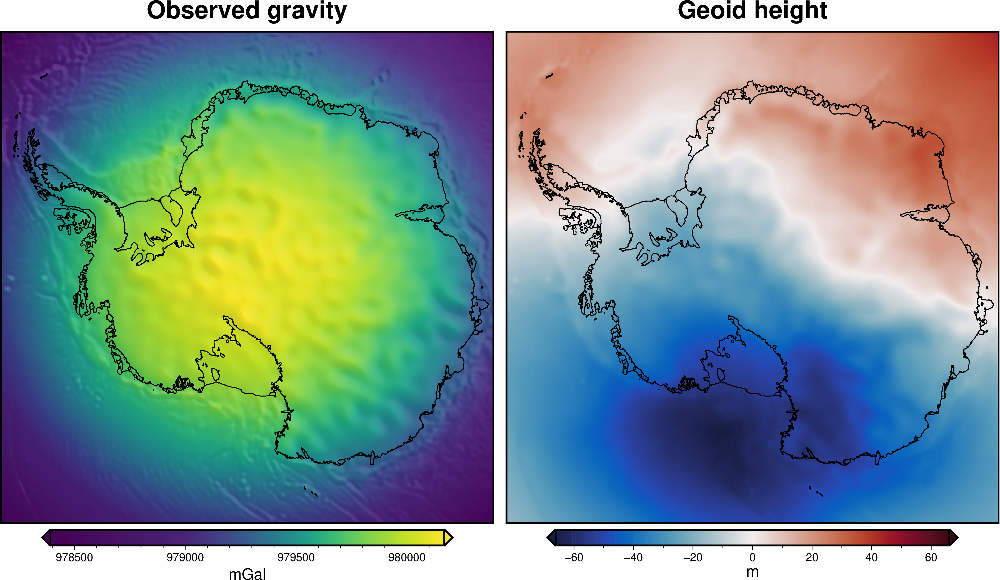

In [7]:
# plot gravity data
fig = maps.plot_grd(
    eigen_gravity,
    coast=True,
    region=region,
    grd2cpt=True,
    cmap='viridis',
    cbar_label='mGal',
    title='Observed gravity',
    shading="+a45+nt0.2",
    )

# get max absolute value of geoid
maxabs = verde.maxabs(eigen_geoid)
# plot geoid 
fig = maps.plot_grd(
    eigen_geoid,
    coast=True,
    region=region,
    cmap='balance+h0',
    cpt_lims=[-maxabs, maxabs],
    cbar_label='m',
    title='Geoid height',
    fig=fig,
    origin_shift='xshift',
    )

fig.show()

## Calculate Normal gravity
at 10km altitude, relative to the ellipsoid

In [8]:
# calculated normal gravity at all Eigen observation locations for a given latitude and height
df['normal_gravity_obs'] = boule.WGS84.normal_gravity(
    latitude = df.lat, 
    height = df.obs_height_ellipsoid,
    )

# convert results back to a grid
normal_gravity = pygmt.xyz2grd(
    data=df[['x','y','normal_gravity_obs']],
    region=region,
    spacing=5000,
    registration='g',
    )

## Calculate gravity disturbance

Gravity disturbances are the differences between the measured gravity and a reference (normal) gravity produced by an ellipsoid:

$$
\delta g (p) = g (p) - \gamma (p)
$$

in which $\delta g$ is the **gravity disturbance**, $g$ is the **measured gravity**, $\gamma$ is the **normal gravity** and p is the observation point where the gravity measurement has been carried out.

In [9]:
gravity_disturbance = eigen_gravity - normal_gravity

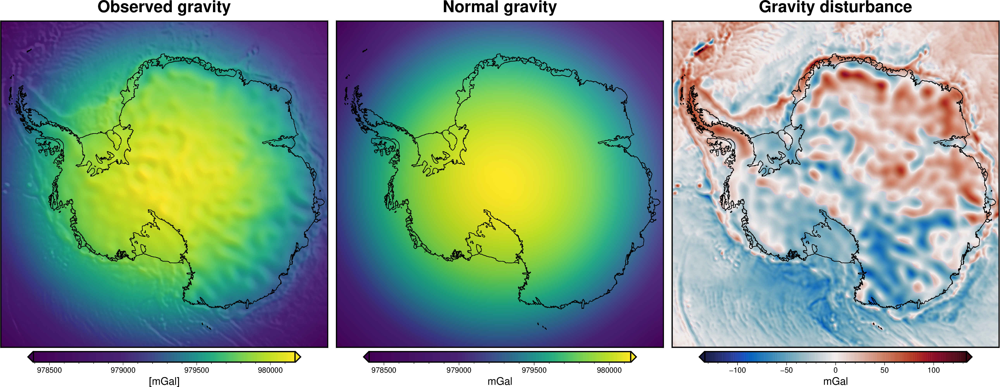

In [10]:
# plot observed gravity
fig = maps.plot_grd(
    eigen_gravity,
    coast=True,
    region=region,
    grd2cpt=True,
    cmap='viridis',
    cbar_label='[mGal]',
    title='Observed gravity',
    shading="+a45+nt0.2",
    )

# plot normal gravity
fig = maps.plot_grd(
    normal_gravity,
    coast=True,
    region=region,
    grd2cpt=True,
    cmap='viridis',
    cbar_label='mGal',
    title='Normal gravity',
    shading="+a45+nt0.2",
    fig=fig,
    origin_shift='xshift',
    )

# get max absolute value of the disturbance
maxabs = verde.maxabs(gravity_disturbance)
# plot gravity disturbance
fig = maps.plot_grd(
    gravity_disturbance,
    coast=True,
    region=region,
    cmap='balance+h0',
    cpt_lims=[-maxabs, maxabs],
    cbar_label='mGal',
    title='Gravity disturbance',
    shading="+a45+nt0.2",
    fig=fig,
    origin_shift='xshift',
    )

fig.show()

## Calculate free-air anomaly

Next, we calculate the free-air anomaly:

$$
\Delta g^F = \left(g(p) + 0.3086 H(p)\right) - \gamma_Q
$$

in which $g$ is the **measured gravity**, $H$ is the **orthometric height** (geoidal) of the observation point and $\gamma_Q$ is the **normal gravity** calculated on the surface of the ellipsoid (to account for latitudinal variations).

In [15]:
# # METHOD 1
# # calculated normal gravity on the ellipsoid (height=0)
# df['normal_gravity_on_ellipsoid'] = boule.WGS84.normal_gravity(
#     latitude = df.lat, 
#     height = 0,
#     )

# # compute the anomaly from the above equation
# df['free_air_anomaly'] = (df.gravity + 0.3086*df.obs_height_geoid) - df.normal_gravity_on_ellipsoid

# METHOD 2 - This looks correct, compared to AntGG 
# calculated normal gravity on the ellipsoid (height=0)
df['normal_gravity_obs_geoid'] = boule.WGS84.normal_gravity(
    latitude = df.lat, 
    height = df.obs_height_geoid,
    )

# convert results back to a grid
normal_gravity_geoid = pygmt.xyz2grd(
    data=df[['x','y','normal_gravity_obs_geoid']],
    region=region,
    spacing=5000,
    registration='g',
    )

# compute the anomaly from the above equation
df['free_air_anomaly'] = df.gravity - df.normal_gravity_obs_geoid

# convert results back to a grid
free_air_anomaly = pygmt.xyz2grd(
    data=df[['x','y','free_air_anomaly']],
    region=region,
    spacing=5000,
    registration='g',
    )

df.describe()

,y,x,gravity,geoid,lat,lon,obs_height_ellipsoid,obs_height_geoid,normal_gravity_obs,normal_gravity_obs_geoid,free_air_anomaly,geoid_time_0.3086
count,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1256641.0,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06,1.256641e+06
mean,0.000000e+00,0.000000e+00,9.794899e+05,-1.412881e+01,-7.051815e+01,8.021384e-02,10000.0,9.985871e+03,9.794992e+05,9.795036e+05,-1.374400e+01,4.360153e+00
std,1.618024e+06,1.618024e+06,3.798443e+02,2.810496e+01,7.146467e+00,1.034039e+02,0.0,2.810496e+01,3.841061e+02,3.864205e+02,3.695408e+01,8.673191e+00
min,-2.800000e+06,-2.800000e+06,9.783914e+05,-6.612411e+01,-9.000000e+01,-1.798977e+02,10000.0,9.933876e+03,9.784018e+05,9.783878e+05,-1.127190e+02,-1.403672e+01
25%,-1.400000e+06,-1.400000e+06,9.792184e+05,-3.760931e+01,-7.552258e+01,-8.989769e+01,10000.0,9.962391e+03,9.792241e+05,9.792270e+05,-4.040822e+01,-3.536153e+00
50%,0.000000e+00,0.000000e+00,9.794986e+05,-1.665719e+01,-6.962867e+01,0.000000e+00,10000.0,9.983343e+03,9.795109e+05,9.795153e+05,-1.587883e+01,5.140410e+00
75%,1.400000e+06,1.400000e+06,9.798091e+05,1.145869e+01,-6.517465e+01,9.000000e+01,10000.0,1.001146e+04,9.798166e+05,9.798227e+05,1.457409e+01,1.160623e+01
max,2.800000e+06,2.800000e+06,9.801678e+05,4.548516e+01,-5.467353e+01,1.800000e+02,10000.0,1.004549e+04,9.801423e+05,9.801514e+05,1.413597e+02,2.040590e+01


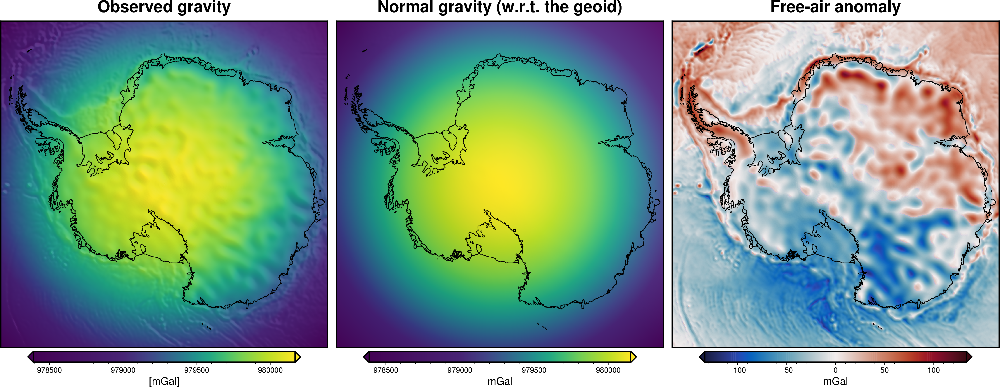

In [16]:
# plot observed gravity
fig = maps.plot_grd(
    eigen_gravity,
    coast=True,
    region=region,
    grd2cpt=True,
    cmap='viridis',
    cbar_label='[mGal]',
    title='Observed gravity',
    shading="+a45+nt0.2",
    )

# plot normal gravity
fig = maps.plot_grd(
    normal_gravity_geoid,
    coast=True,
    region=region,
    grd2cpt=True,
    cmap='viridis',
    cbar_label='mGal',
    title='Normal gravity (w.r.t. the geoid)',
    shading="+a45+nt0.2",
    fig=fig,
    origin_shift='xshift',
    )

# get max absolute value of the disturbance
maxabs = verde.maxabs(gravity_disturbance)
# plot gravity disturbance
fig = maps.plot_grd(
    free_air_anomaly,
    coast=True,
    region=region,
    cmap='balance+h0',
    cpt_lims=[-maxabs, maxabs],
    cbar_label='mGal',
    title='Free-air anomaly',
    shading="+a45+nt0.2",
    fig=fig,
    origin_shift='xshift',
    )

fig.show()

## Compare the disturbance and the anomaly

returning original grid
returning original grid


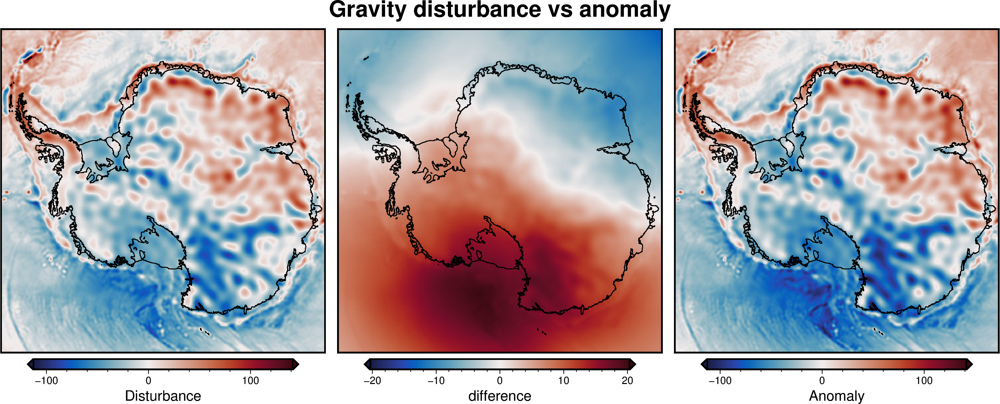

In [12]:
# compare grids
eigen_diff_grids = utils.grd_compare(
    gravity_disturbance,
    free_air_anomaly,
    plot=True,
    grid1_name='Disturbance',
    grid2_name='Anomaly',
    title='Gravity disturbance vs anomaly',
    inset=False,
    cmap='balance+h',
    diff_cmap='balance',
    )

## Compare to values given by the AntGG 2020 prereleased data

returning grid with new region and/or registration, same spacing
returning grid with new region and/or registration, same spacing
returning original grid
returning original grid


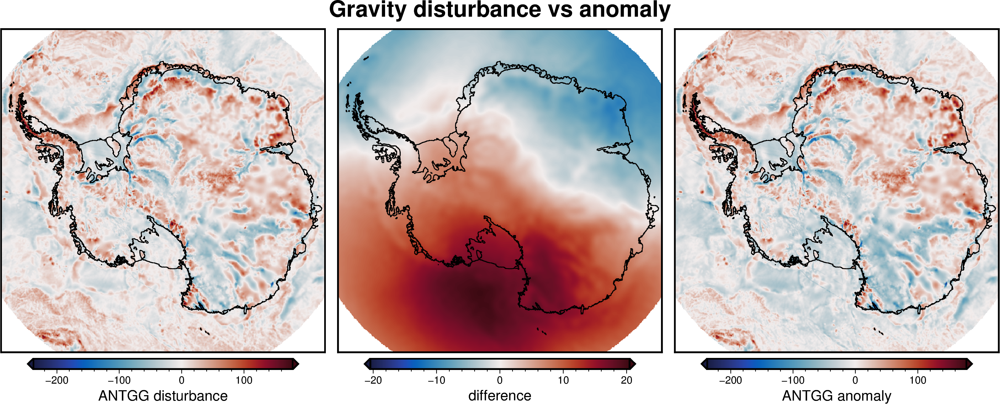

In [13]:
# fetch the AntGG gravity disturbance
ANTGG_disturbance =  fetch.gravity(
    version='antgg-update', 
    anomaly_type='DG',
    resolution=5e3,
    region=region,
    registration='g',
    )

# fetch the AntGG free-air-anomaly  
ANTGG_anomaly =  fetch.gravity(
    version='antgg-update', 
    anomaly_type='FA',
    resolution=5e3,
    region=region,
    registration='g',
    )

# compare grids
anttgg_diff_grids = utils.grd_compare(
    ANTGG_disturbance,
    ANTGG_anomaly,
    plot=True,
    grid1_name='ANTGG disturbance',
    grid2_name='ANTGG anomaly',
    title='Gravity disturbance vs anomaly',
    inset=False,
    cmap='balance+h',
    diff_cmap='balance',
    )

## What is the actual difference?

Here, we multiple the geoid model by -0.3086mGal to show that the difference between the disturbance and the anomaly is approximated very closely as the the free air correction 

Free-air correction = $0.3086 H(p)$

returning original grid
returning original grid


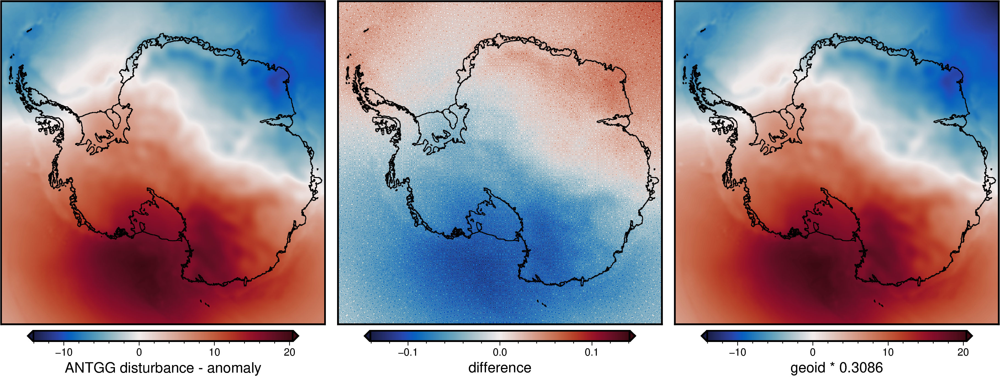

In [14]:
df['geoid_time_0.3086'] = df.geoid * -0.3086

# convert to a grid
grid = pygmt.xyz2grd(
    data=df[['x','y','geoid_time_0.3086']],
    region=region,
    spacing=5000,
    registration='g',
    )

# compare grids
grids = utils.grd_compare(
    eigen_diff_grids[0], #difference between AnttGG disturbance and anomaly
    grid,
    plot=True,
    grid1_name='ANTGG disturbance - anomaly',
    grid2_name='geoid * 0.3086',
    title='',
    inset=False,
    cmap='balance+h',
    diff_cmap='balance',
    )